#Attempting Another One by the Jumping Spiders Team
> These tests were conducted by Alexia Rangel K.

First step really is research (again). I started watching videos on what people recommend for text detecting in images.


*   [Detect Text in Images with Python - pytesseract vs. easyocr vs keras_ocr](https://www.youtube.com/watch?v=oyqNdcbKhew)
    <br> Uses the same dataset that I was using. Pytesseract, easyocr, and keras_ocr are all used to extract text from images. Good thing is that it can focus on specific text, but I worry that it won't be able to see specific characters.
  * Pytesseract: Works best on documents. For things like the dataset that we first used, its not effective.
  * Easyocr: slower to run, the result is the bbox, letter, and confidence value of what it's just read. There's a lot of adjustments that you can make too. Seems much better
  * Keras_ocr: Have a pipeline feature that can be used to run on the images. It returns a bounding box and text. Has an annotation tool so you can see where the image finds the text. Seems like it gets overloaded easily
  * They compare more keras_ocr and easyocr since they work the best on the provided images. It seems like Easyocr has case sensitivity
*   [Simple OCR in Python with easyocr](https://www.youtube.com/watch?v=GboDfGzkRsQ)
  <br> I'm interested in easy OCR now so let's see what this'll be like.




---


In [1]:
#Mounting the google drive
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
#Directions
%cd /content/drive/MyDrive/Colab Notebooks/data_folder/tjs-butterfly-imagetotext/
%ldir

/content/drive/MyDrive/Colab Notebooks/data_folder/tjs-butterfly-imagetotext
drwx------ 2 root      4096 Mar 10 21:31 Butterflies (OLD)/
drwx------ 2 root      4096 Feb 11 01:13 train_images/
drwx------ 2 root      4096 Mar 10 21:52 unprocessed_copy/


In [3]:
import pandas as pd #Dataframe stuff
import os #Used to navigate through file structures
import cv2
import numpy as np

!pip install easyocr
import easyocr  #Hopefully our ocr method. Use pip install easyocr if it gives you trouble
from google.colab.patches import cv2_imshow as show_img
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 22.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 70.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 73.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 48.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 54.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 28.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9

In [4]:
bufferflies_df = pd.read_csv('VerbatimData-31025.csv')

In [5]:
bufferflies_df.head(10)

,id,img_name,Scientific_name,Sex,Tag,Info1,Info2,Info3,Info4
0,MGCL 1163541,MGCL 1163541_8006.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163541,"JAMAICA, W. I. 1962 St. Andrew Aug 10 Mona Are...",P. Milner coll. MGCL Accession # 2010-5,NaN,NaN
1,MGCL 1163542,MGCL 1163542_8008.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163542,"JAMAICA, W. I. 1962 St. Andrew 15 July Bull Ba...",P. Milner coll. MGCL Accession # 2010-5,NaN,NaN
2,MGCL 1163543,MGCL 1163543_8010.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163543,"JAMAICA, W. I. 1962 St. Andrew July 1 Hope Gdn...",P. Milner coll. MGCL Accession # 2010-5,NaN,NaN
3,MGCL 1163544,MGCL 1163544_8012.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163544,"JAMAICA, W. I. 1962 Kingston St. Andrews Aug 1...",P. Milner coll. MGCL Accession # 2010-5,NaN,NaN
4,MGCL 1163545,MGCL 1163545_8014.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163545,"JAMAICA, W. I. St. Andrews 15 July Bull Bay 19...",P. Milner coll. MGCL Accession # 2010-5,NaN,NaN
5,MGCL 1163546,MGCL 1163546_8016.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163546,"Toll Gate, Clarendon Parish JAMAICA 12/16/70 C...",Phoebis eubule sennae,Generic MGCL Accession unnumbered,NaN
6,MGCL 1163547,MGCL 1163547_8018.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163547,"JAMAICA, W. I. St. Andrews 15 July Bull Bay 19...",P. Milner coll. MGCL Accession # 2010-5,NaN,NaN
7,MGCL 1163548,MGCL 1163548_8020.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163548,ROSE HALL PLANTATION ST. JAMES PARISH MONTIEGO...,January 1991,Phoebis sennae sennae ♂,RC Holliaster colln. MGCL Acc. no. 2005-20
8,MGCL 1163549,MGCL 1163549_8022.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163549,ROSE HALL PLANTATION ST. JAMES PARISH MONTIEGO...,January 1991,Phoebis sennae sennae ♂,RC Holliaster colln. MGCL Acc. no. 2005-20
9,MGCL 1163550,MGCL 1163550_8024.JPG,Phoebis sennae sennae,♂,UF FLMNH MGCL 1163550,"JAMAICA: St. Catherine Par. : Hellshire Hills,...",G T Austin colln MGCL Acc. 2004-5,NaN,NaN


## Preprocessing
Cause we still want to do it for all our images.

In [6]:
reader = easyocr.Reader(['en'], gpu = False)

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

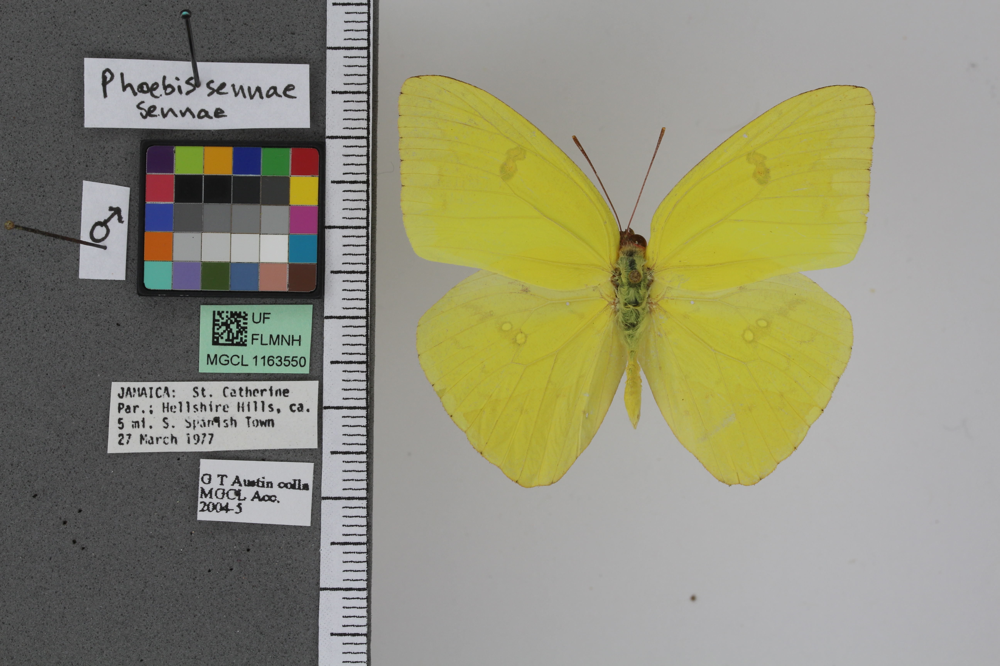

In [86]:
image = cv2.imread("unprocessed_copy/MGCL 1163550_8024.JPG")
show_img(image)

So overall, without preprocessing, it sucks. So lets try to fix that now.

In [10]:
def inverse(image):
  return cv2.bitwise_not(image)

In [11]:
def grayscale(image):
  return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [12]:
def binarization(image):
  # Apply Adaptive Thresholding: this is supposed to be better for images with variable lighting and conditions
  # https://docs.opencv.org/4.x/d7/d4d/tutorial_py_thresholding.html
  # image = cv2.adaptiveThreshold(image,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
  #                             cv2.THRESH_BINARY,11,2)
  _, image = cv2.threshold(image, 200, 230, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
  return image

In [56]:
def noise_removal(image):
  kernal = np.ones((1, 1), np.uint8)
  image = cv2.dilate(image, kernal, iterations=1)
  kernal = np.ones((1, 1), np.uint8)
  image = cv2.erode(image, kernal, iterations=1)
  image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernal)
  # image = cv2.medianBlur(image, 3)

  # Apply Gaussian filter (COMPARE TO MEDIANBLUR)
  sigma = 1  # Standard deviation for Gaussian kernel (higher = more blur)
  image = gaussian_filter(image, sigma=sigma)

  return image

In [14]:
def thin_font(image):
  image = cv2.bitwise_not(image)
  kernal = np.ones((2, 2), np.uint8)
  image = cv2.erode(image, kernal, iterations=1)
  image = cv2.bitwise_not(image)
  return image

In [145]:
def thick_font(image):
  image = cv2.bitwise_not(image)
  kernal = np.ones((2, 2), np.uint8)
  image = cv2.dilate(image, kernal, iterations=2)
  image = cv2.bitwise_not(image)
  return image

In [155]:
def blurring(image):
  # Apply Gaussian filter
  sigma = 0.5  # Standard deviation for Gaussian kernel (higher = more blur)
  return gaussian_filter(image, sigma=sigma)

In [156]:
def imgEnhancement(image):
  # Apply CLAHE Algorithm
  clahe = cv2.createCLAHE(clipLimit=5)
  return clahe.apply(image) + 5

In [167]:
def imgPreprocessing(img_path):
  image = cv2.imread(img_path)

  # image = grayscale(image)
  # image = blurring(image)
  # image = binarization(image)

  # image = inverse(image)

  image = grayscale(image)

  #image = imgEnhancement(image)

  image = blurring(image)

  #image = binarization(image)

  # image = noise_removal(image)

  # image = thin_font(image)

  image = thick_font(image)

  image = binarization(image)

  return (image)

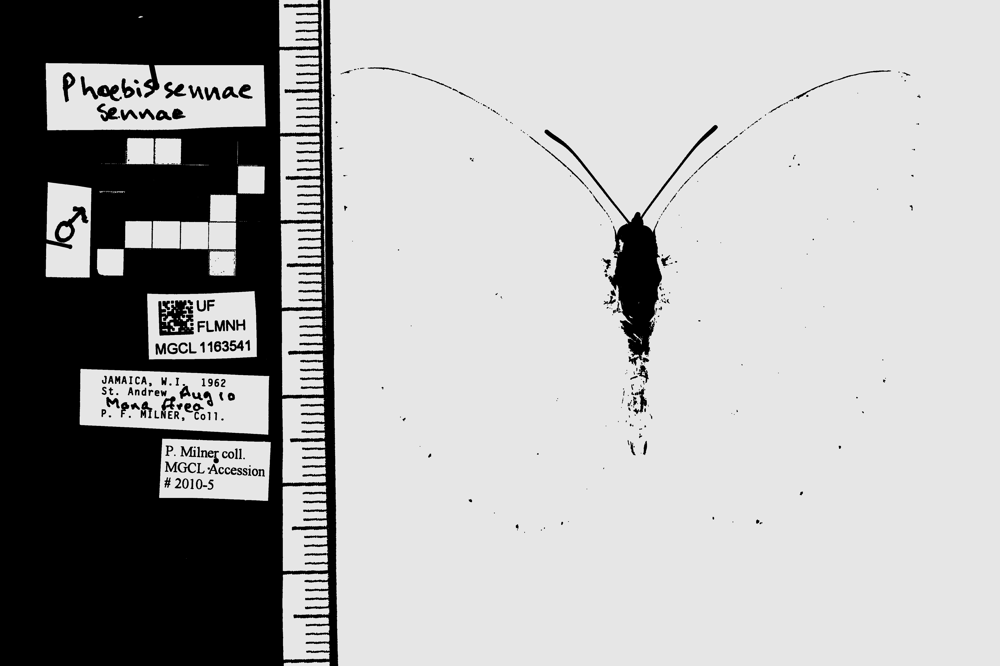

In [168]:
# test = imgPreprocessing("unprocessed_copy/MGCL 1163550_8024.JPG")
test = imgPreprocessing("unprocessed_copy/MGCL 1163541_8006.JPG")
show_img(test)

1592


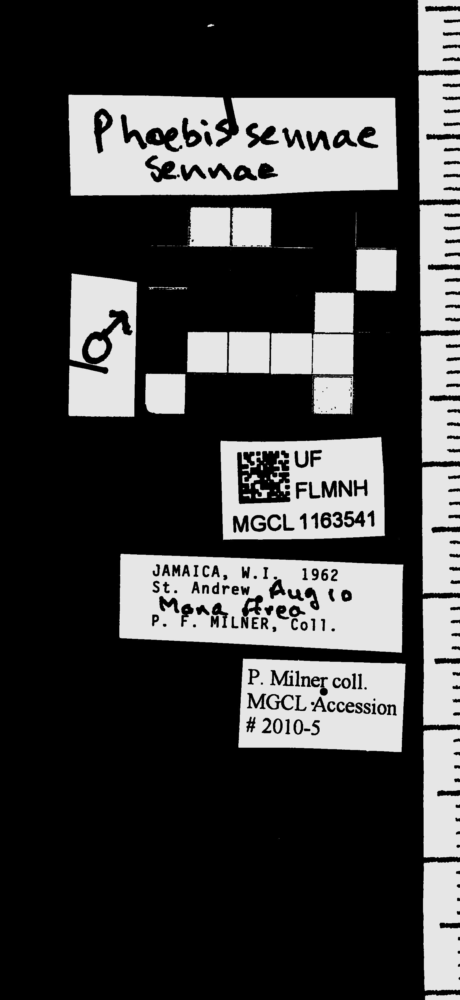

In [179]:
height, width = test.shape
new_Width = (width // 2) - 1000
print(new_Width)
left_Half = test[:, :new_Width]
show_img(left_Half)

In [180]:
results = reader.readtext(left_Half)

In [181]:
testDF = pd.DataFrame(results, columns = ['bbox', 'text', 'confidence'])
testDF

,bbox,text,confidence
0,"[[303, 363], [1334, 363], [1334, 549], [303, 5...",phcebissewnae,0.409337
1,"[[1480, 0], [1592, 0], [1592, 631], [1480, 631]]",,0.000000
2,"[[491, 523], [975, 523], [975, 644], [491, 644]]",Sennae,0.698175
3,"[[1013, 1545], [1124, 1545], [1124, 1629], [10...",UF,0.999630
4,"[[1014, 1645], [1288, 1645], [1288, 1736], [10...",FLMNH,0.999945
5,"[[798, 1749], [1313, 1749], [1313, 1852], [798...",MGCL 1163541,0.994289
6,"[[517, 1930], [801, 1930], [801, 2016], [517, ...","JAMAICA,",0.998856
7,"[[827, 1948], [951, 1948], [951, 2013], [827, ...",W. I,0.490452
8,"[[1031, 1948], [1182, 1948], [1182, 2022], [10...",1962,0.999993
9,"[[518, 1998], [607, 1998], [607, 2059], [518, ...",St_,0.937669


In [163]:
!pip install supervision
import supervision as sv

In [164]:
def draw_bounding_boxes(image, detections):
  for bbox, text, score in detections:
    cv2.rectangle(image, tuple(map(int, bbox[0])), tuple(map(int, bbox[2])), (0, 255, 0), 5)
    cv2.putText(image, text, tuple(map(int, bbox[0])), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 0, 255), 5)

In [182]:
new_Test = left_Half
new_Test = cv2.cvtColor(new_Test, cv2.COLOR_BGR2RGB)
draw_bounding_boxes(new_Test, results)

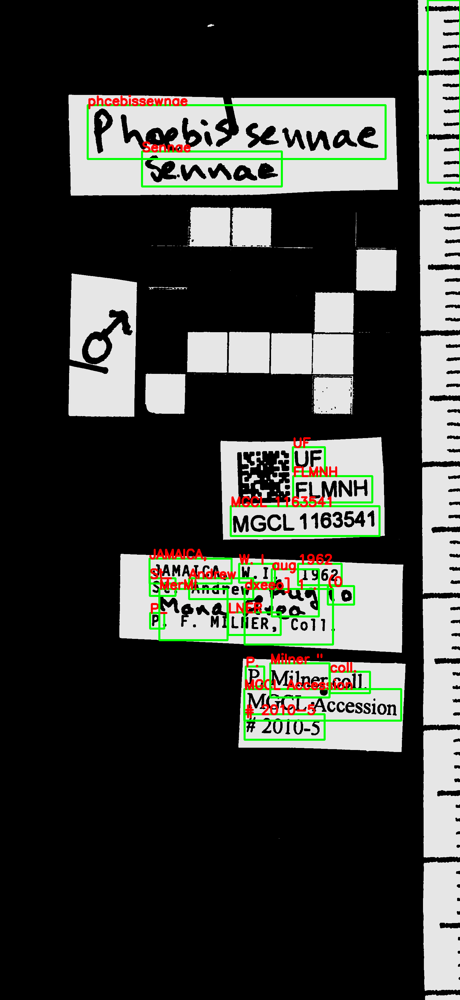

In [183]:
show_img(new_Test)

Now I want to apply this to all the images and compare the outputs.